# 🌿 Plant Disease Detection: Live Demo
**Project:** Foundational AI Course

**Student:** Tadiwos Andargie and Daniel Manga

This notebook demonstrates the real-time performance of the trained MobileNetV2 model.
We will load the saved model and test it on new images downloaded from the internet.

In [ ]:
#prepare tensorflow

!pip install tensorflow
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.utils import load_img, img_to_array

In [ ]:
#upload model
from google.colab import files
files.upload()
#plant_disease_model_60_20_20.keras

Saving plant_disease_model_60_20_20.keras to plant_disease_model_60_20_20.keras


{'plant_disease_model_60_20_20.keras': b'PK\x03\x04\x14\x00\x00\x00\x00\x00\x00\x00!\x00,\xd1SH@\x00\x00\x00@\x00\x00\x00\r\x00\x00\x00metadata.json{"keras_version": "3.10.0", "date_saved": "2025-12-10@22:35:49"}PK\x03\x04\x14\x00\x00\x00\x00\x00\x00\x00!\x00\xfc\xb94\xcb\xafn\x02\x00\xafn\x02\x00\x0b\x00\x00\x00config.json{"module": "keras.src.models.functional", "class_name": "Functional", "config": {"name": "functional", "trainable": true, "layers": [{"module": "keras.layers", "class_name": "InputLayer", "config": {"batch_shape": [null, 224, 224, 3], "dtype": "float32", "sparse": false, "ragged": false, "name": "input_layer_1"}, "registered_name": null, "name": "input_layer_1", "inbound_nodes": []}, {"module": "keras.src.models.functional", "class_name": "Functional", "config": {"name": "mobilenetv2_1.00_224", "trainable": false, "layers": [{"module": "keras.layers", "class_name": "InputLayer", "config": {"batch_shape": [null, 224, 224, 3], "dtype": "float32", "sparse": false, "ragg

In [ ]:
#load
model = tf.keras.models.load_model('plant_disease_model_60_20_20.keras')
print("model loaded successfully!")

model loaded successfully!


### 🔍 Predict a New Image
Run the cell below to upload a plant leaf image. The model will analyze it and predict the disease class with a confidence score.

In [ ]:
#class names
#copy list from the main notebook
class_names = ['Apple___Apple_scab', 'Apple___Black_rot', 'Apple___Cedar_apple_rust',
               'Apple___healthy', 'Blueberry___healthy', 'Cherry_(including_sour)___Powdery_mildew',
               'Cherry_(including_sour)___healthy', 'Corn_(maize)___Cercospora_leaf_spot_Gray_leaf_spot',
               'Corn_(maize)___Common_rust_', 'Corn_(maize)___Northern_Leaf_Blight', 'Corn_(maize)___healthy',
               'Grape___Black_rot', 'Grape___Esca_(Black_Measles)', 'Grape___Leaf_blight_(Isariopsis_Leaf_Spot)',
               'Grape___healthy', 'Orange___Haunglongbing_(Citrus_greening)', 'Peach___Bacterial_spot',
               'Peach___healthy', 'Pepper,_bell___Bacterial_spot', 'Pepper,_bell___healthy',
               'Potato___Early_blight', 'Potato___Late_blight', 'Potato___healthy',
               'Raspberry___healthy', 'Soybean___healthy', 'Squash___Powdery_mildew',
               'Strawberry___Leaf_scorch', 'Strawberry___healthy', 'Tomato___Bacterial_spot',
               'Tomato___Early_blight', 'Tomato___Late_blight', 'Tomato___Leaf_Mold',
               'Tomato___Septoria_leaf_spot', 'Tomato___Spider_mites_Two-spotted_spider_mite',
               'Tomato___Target_Spot', 'Tomato___Tomato_Yellow_Leaf_Curl_Virus', 'Tomato___Tomato_mosaic_virus',
               'Tomato___healthy']

#predict function
def predict_image(image_path, model):
  img = load_img(image_path, target_size=(224, 224))
  img_array = img_to_array(img)
  img_batch = np.expand_dims(img_array, axis=0)

  prediction = model.predict(img_batch)

  predicted_class = class_names[np.argmax(prediction[0])]
  confidence = np.max(prediction[0]) * 100

  plt.imshow(img)
  plt.title(f"{predicted_class} ({confidence:.2f}%)")
  plt.axis("off")

Saving Rose_Mosaic.jpg to Rose_Mosaic.jpg
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 401ms/step


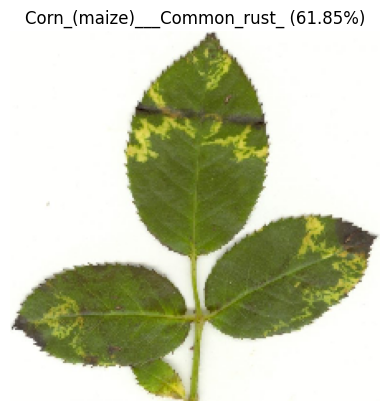

In [15]:
#upload a test image
from google.colab import files
uploaded = files.upload()

#filename of the uploaded image
filename = list(uploaded.keys())[0]

# Run prediction!
predict_image(filename, model)